Compiling model...
Building feed-forward neural network...
'build' took 0.086223 s

'compile' took 1.829352 s

Training model...

0         [2.34e+00, 4.00e+02, 2.61e+01]    [3.05e+00, 4.00e+02, 2.61e+01]    []  
1000      [2.41e+00, 2.94e+02, 1.68e+01]    [1.48e+00, 2.94e+02, 1.68e+01]    []  
2000      [7.32e-02, 1.04e+02, 7.77e+00]    [5.21e-02, 1.04e+02, 7.77e+00]    []  
3000      [1.28e-01, 7.24e+01, 7.05e+00]    [6.25e-02, 7.24e+01, 7.05e+00]    []  
4000      [3.21e-01, 5.79e+01, 6.90e+00]    [1.36e-01, 5.79e+01, 6.90e+00]    []  
5000      [5.47e-01, 4.75e+01, 6.89e+00]    [2.24e-01, 4.75e+01, 6.89e+00]    []  
6000      [6.57e-01, 3.90e+01, 6.89e+00]    [2.56e-01, 3.90e+01, 6.89e+00]    []  
7000      [6.06e-01, 3.17e+01, 6.89e+00]    [2.90e-01, 3.17e+01, 6.89e+00]    []  
8000      [4.93e-01, 2.53e+01, 6.89e+00]    [4.73e-01, 2.53e+01, 6.89e+00]    []  
9000      [2.67e-01, 1.98e+01, 6.89e+00]    [2.88e-01, 1.98e+01, 6.89e+00]    []  
10000     [5.49e-03, 1.48e+01, 6.89e+00]

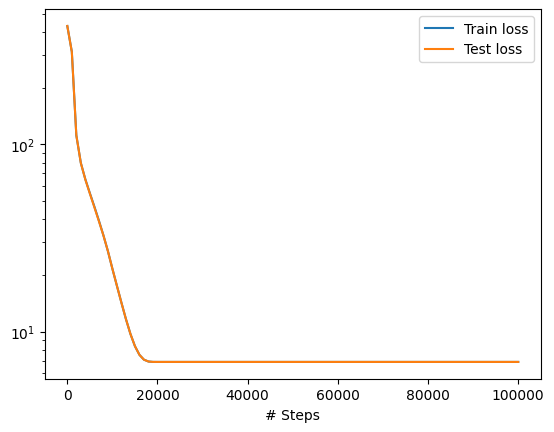

In [9]:
import os
os.environ['DDE_BACKEND'] = 'tensorflow'
import pandas as pd
import numpy as np
import tensorflow as tf
import deepxde as dde
import matplotlib.pyplot as plt

# Problem constants
N = 1e7
L = 6e-2  # m
R = 4e-3  # m
t_last = 0.1  # s
D_L = 3.8e-11*N  # m^2/s
V_H = 2e-6     # m^3/mole
RT = 8.314 * 298  # J/mole
Coe = (D_L * V_H) / RT

# Define Geometry and Time Domain
square = dde.geometry.Rectangle([0, 0], [L, L])
circle = dde.geometry.Disk([0, 0], R)
geom = dde.geometry.csg.CSGDifference(square, circle)
timedomain = dde.geometry.TimeDomain(0, t_last)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

# Initial condition for C_L
def initial_condition(x):
    return 20.0  # Initial value of C_L

ic = dde.icbc.IC(geomtime, initial_condition, lambda x, on_initial: on_initial, component=0)

Delta_t = 0.01  # Adjust as needed

# PDE residual function
def pde_C_L(x, y):
    # Extract variables
    C_L_current = y[:, 0:1]
    # Predict C_L at next time step using the neural network
    C_L_next_pred = y[:,2:3]
    
    # Compute spatial derivatives at current time
    CL_x = dde.grad.jacobian(y, x, i=0, j=0)
    CL_y = dde.grad.jacobian(y, x, i=0, j=1)
    CL_xx = dde.grad.hessian(y, x, component=0, i=0, j=0)
    CL_yy = dde.grad.hessian(y, x, component=0, i=1, j=1)
    sigma_t=dde.grad.jacobian(y,x,i=1,j=2)
    sigma_x = dde.grad.jacobian(y, x, i=1, j=0)
    sigma_y = dde.grad.jacobian(y, x, i=1, j=1)
    sigma_xx = dde.grad.hessian(y, x, component=1, i=0, j=0)
    sigma_yy = dde.grad.hessian(y, x, component=1, i=1, j=1)
    # Compute sigma_H and its derivatives at current time
    # (Assuming sigma_H is time-independent or provided)
    
    # Compute the FDM expression for C_L_next
    C_L_next_FDM = C_L_current + N*Delta_t * (D_L * (CL_xx + CL_yy) - Coe * N * (CL_x * sigma_x+ CL_y * sigma_y+ C_L_current * (sigma_xx + sigma_yy)))
    
    # Define the residual as the difference between predicted and computed C_L_next
    residual = C_L_next_pred - C_L_next_FDM
    
    return [residual]

# Observed data (if available)
# Load your observed data for sigma (or any other variable)
df_observed = pd.read_excel('Hydrostatic Data with Nodes.xlsx')
x_observed = df_observed['x'].values.reshape(-1, 1)
y_observed = df_observed['y'].values.reshape(-1, 1)
t_observed = np.zeros_like(x_observed)  # Assuming observations at t=0
sigma_observed = df_observed['sigma'].values.reshape(-1, 1)/N
X_observed = np.hstack((x_observed, y_observed, t_observed))

# Define the boundary condition for sigma (if needed)
def sigma_observed_func(x):
    # Interpolate or provide sigma values at the observed points
    return sigma_observed

# Create PointSet for observed data
observe_sigma = dde.icbc.PointSetBC(X_observed, sigma_observed, component=1)

# Define the data
data = dde.data.TimePDE(
    geomtime,
    pde_C_L,
    [ic, observe_sigma],  # Include observed data
    num_domain=1000,
    num_boundary=500,
    num_initial=500,
    num_test=1000,
)

# Define the neural network
layer_size = [3] + [64] * 6 + [3]  # 3 inputs (x, y, t) and 2 outputs (C_L, sigma)
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Compile the model
model = dde.Model(data, net)
model.compile(
    "adam",
    lr=1e-5  # Adjust loss weights as needed
)

# Train the model
losshistory, train_state = model.train(epochs=100000)

# Plot the loss history
dde.saveplot(losshistory, train_state, issave=True, isplot=True)


Prediction for (x=0.0247037895, y=0.0131040001, t=0.0): 19.999526977539062
Prediction for (x=0.0267249476, y=0.0520194769, t=0.0): 20.00045394897461
Prediction for (x=0.00625628559, y=0.0350608677, t=0.0): 19.999740600585938
Prediction for (x=0.00106006162, y=0.00397472549, t=0.0): 19.998685836791992
Prediction for (x=0.0186403152, y=0.0599999987, t=0.0): 20.000484466552734
Prediction for (x=0.00384563557, y=0.00209631748, t=0.0): 19.998695373535156
Prediction for (x=0.00234241528, y=0.00431229454, t=0.0): 19.99873161315918
Prediction for (x=0.0114698568, y=0.058004871, t=0.0): 20.000349044799805
Prediction for (x=0.0398624763, y=0.0500243492, t=0.0): 20.00058937072754
Prediction for (x=0.00224974239, y=0.00747497054, t=0.0): 19.99883460998535
Prediction for (x=0.00461221021, y=0.000789329468, t=0.0): 19.99867057800293
Prediction for (x=0.0226826314, y=0.0200973917, t=0.0): 19.999677658081055
Prediction for (x=0.0408730544, y=0.0120959999, t=0.0): 19.99982261657715
Prediction for (x=0.

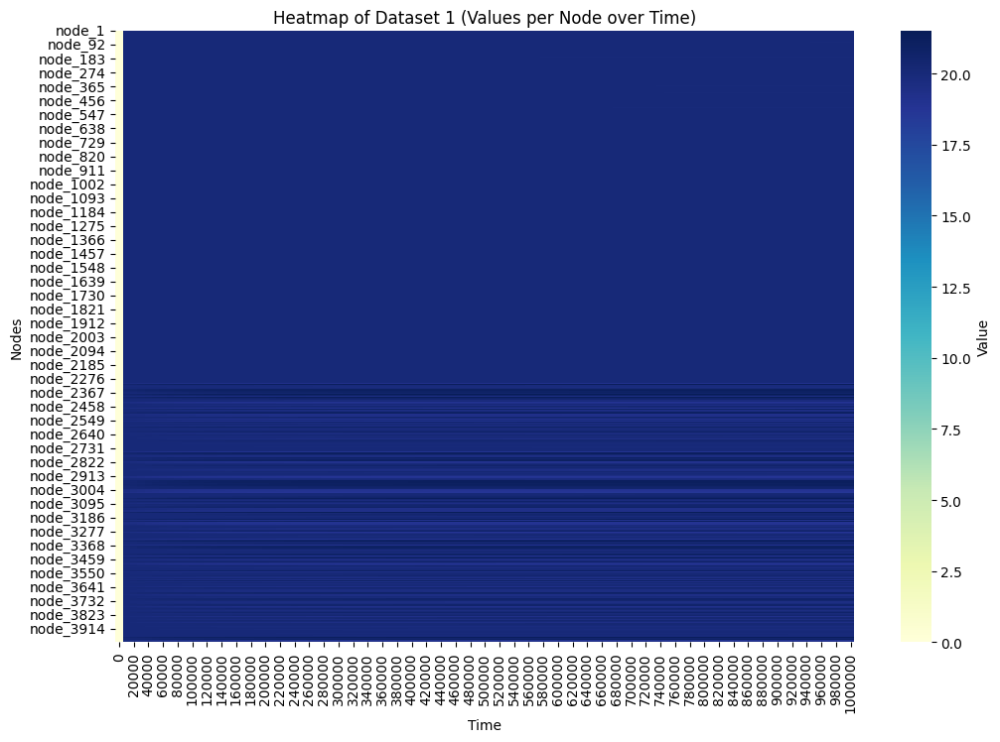

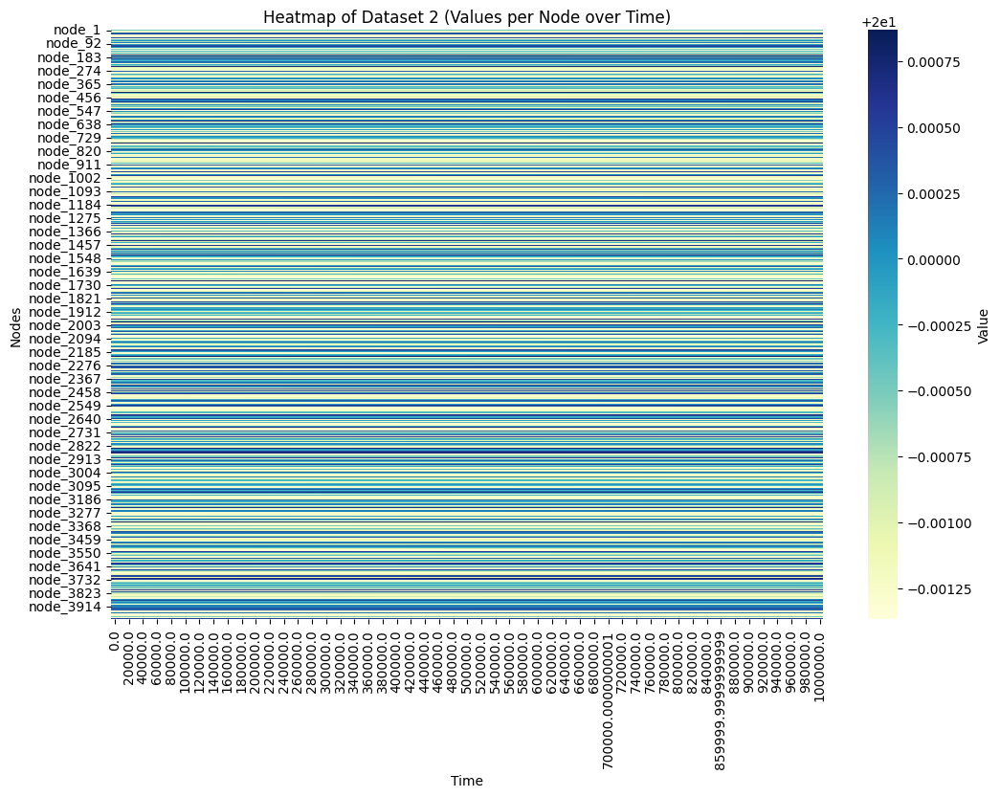

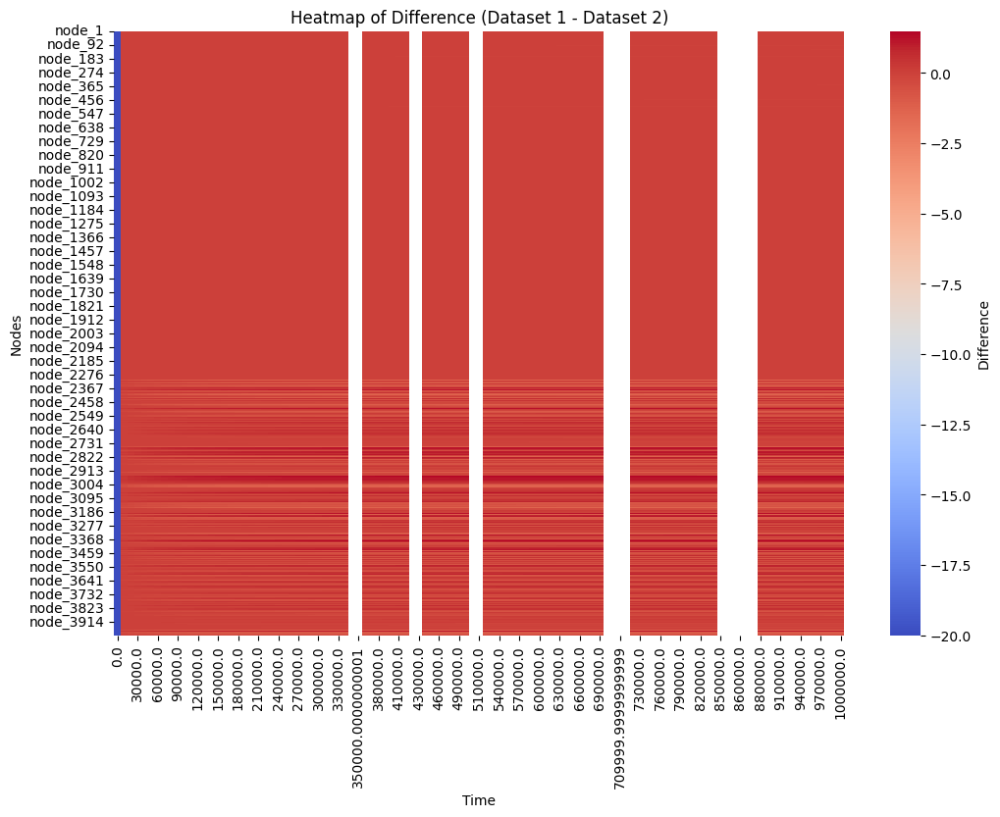

In [12]:
data_observe = pd.read_excel('Hydrostatic Data with Nodes.xlsx')
data_observe_sample = data_observe.sample(frac=1, random_state=7)
x_data = data_observe_sample['x'].values  
y_data = data_observe_sample['y'].values 
sigma_data = data_observe_sample['sigma'].values  
x_coords=data_observe_sample[['x']].values
y_coords=data_observe_sample[['y']].values

# Load Excel data (or CSV for demonstration purposes)
df = pd.read_excel('hydrogen_concentration.xlsx') 
time = df['time'].values
time=np.array(time.tolist())/N
x_coords = np.ravel(np.array(x_coords).reshape([1,-1]))
y_coords = np.ravel(np.array(y_coords).reshape([1,-1]))
time_steps = np.ravel(np.array(time).reshape([1,-1]))  # Example time steps
predictions = np.zeros((len(x_coords), len(y_coords), len(time_steps)))

# Loop through each time step
for t_idx, t in enumerate(time_steps):
    # Loop through all (x, y) combinations
    for i, (x, y) in enumerate(zip(x_coords, y_coords)):
        input_data = np.array([x, y, t]) 
        # Make the prediction for this (x, y, t) combination
        prediction = model.predict([input_data])[0][0]
        print(f"Prediction for (x={x}, y={y}, t={t}): {prediction}")
        # Extract the scalar prediction value (ensure it's not a sequence)
        predictions[:,i,t_idx]=prediction
        # Store the prediction in the correct location

predictions=np.array(predictions[0]).T        
print(predictions)  

import os
def delete_file(filepath):
    # Check if the file exists
    if os.path.exists(filepath):
        try:
            # Delete the file
            os.remove(filepath)
            print(f"File {filepath} successfully deleted.")
        except Exception as e:
            print(f"Error deleting file {filepath}: {e}")
    else:
        print(f"File {filepath} does not exist.")
filepath = "predictions_output.xlsx"

# Delete the file
delete_file(filepath)

print(predictions)
# Flatten the x_coords and y_coords arrays for labeling the columns
x_coords_flat = np.ravel(x_coords)
y_coords_flat = np.ravel(y_coords)

# Prepare column labels as "(x, y)" pairs
column_labels = [f"node_{i+1}" for i in range(len(x_coords_flat))]

# Create a Pandas DataFrame with time steps as rows and (x, y) as columns
df = pd.DataFrame(predictions, columns=column_labels)

# Add a "Time" column to label the time steps
df.insert(0,"time", (time_steps.flatten())*N)

# Export the DataFrame to an Excel file
df.to_excel("predictions_output.xlsx", index=False)

print("Data has been successfully exported to predictions_output.xlsx")


from sklearn.metrics import mean_squared_error, mean_absolute_error

# Load the two Excel files, skipping the first row and first column
df1 = pd.read_excel('hydrogen_concentration.xlsx').iloc[2:, 1:]
df2 = pd.read_excel('predictions_output.xlsx').iloc[2:, 1:]

# Ensure the data is aligned by resetting the indices
df1 = df1.reset_index(drop=True)
df2 = df2.reset_index(drop=True)

# Convert the dataframes to NumPy arrays for easy comparison
data1 = df1.to_numpy()
data2 = df2.to_numpy()

# Calculate similarity metrics
mse = mean_squared_error(data1, data2)
mae = mean_absolute_error(data1, data2)

# Print the results
print(f"Mean Squared Error (MSE): {mse}")
print(f"Mean Absolute Error (MAE): {mae}")

# Optionally, compute element-wise absolute differences
difference = abs(data1 - data2)
print(f"Max Absolute Difference: {difference.max()}")

import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
df3 = pd.read_excel('hydrogen_concentration.xlsx')  # First dataset
df4 = pd.read_excel('predictions_output.xlsx')  # Second dataset



# Heatmap for Dataset 1
plt.figure(figsize=(12, 8))
sns.heatmap(df3.set_index('time').T, cmap="YlGnBu", cbar_kws={'label': 'Value'})
plt.title("Heatmap of Dataset 1 (Values per Node over Time)")
plt.xlabel("Time")
plt.ylabel("Nodes")
plt.show()

# Heatmap for Dataset 2
plt.figure(figsize=(12, 8))
sns.heatmap(df4.set_index('time').T, cmap="YlGnBu", cbar_kws={'label': 'Value'})
plt.title("Heatmap of Dataset 2 (Values per Node over Time)")
plt.xlabel("Time")
plt.ylabel("Nodes")
plt.show()

df_diff = df3.set_index('time') - df4.set_index('time')
# Heatmap for the Difference
plt.figure(figsize=(12, 8))
sns.heatmap(df_diff.T, cmap="coolwarm", cbar_kws={'label': 'Difference'})
plt.title("Heatmap of Difference (Dataset 1 - Dataset 2)")
plt.xlabel("Time")
plt.ylabel("Nodes")
plt.show()

